# Homework 2 (100 Points)

The goal of this homework is to get more practice with clustering and SVD on various datasets.

## Exercise 1 - (50 points)

This exercise will be using the [AirBnB dataset](http://insideairbnb.com/get-the-data.html) for New York City called `listings.csv`. You should find this data in your downloaded repository. If not, it is a resource under Piazza.

a) Produce a [Marker Cluster](https://deparkes.co.uk/2016/06/24/folium-marker-clusters/) using the Folium and Selenium package (you can install them using pip) of the mean listing price per location (lattitude and longitude) over the New York City map. (5 points)

To start, generate a base map of New York City to plot over: (**`location=[40.693943, -73.985880], zoom_start = 11`**). Then, generate and save a `PNG` file named `problem1a.png`. Display it in the cell below as well using the `IPython.display` package.

In [14]:
# Do not edit this cell
import pandas as pd
import numpy as np
import folium #install if you haven't already
import selenium #install if you haven't already
from IPython.display import Image #install if you haven't already

def convert_map_to_png(map, filename):
    """
    Method to convert a folium map to a png file by
    saving the map as an html file and then taking a
    screenshot of the html file on the browser.

    map : folium map object
        The map to be converted to a png file
    filename : str, does not include file type
    """
    import os
    import time
    from selenium import webdriver

    html_filename=f'{filename}.html'
    map.save(html_filename)

    tmpurl=f'file://{os.getcwd()}/{html_filename}'
    
    try:
        try:
            browser = webdriver.Firefox()
        except:
            browser = webdriver.Chrome()
    except:
        browser = webdriver.Safari()

    browser.get(tmpurl)
    time.sleep(5)
    browser.save_screenshot(f'{filename}.png')
    browser.quit()
    os.remove(html_filename)

    return Image(f'{filename}.png')

/var/folders/_5/c3bhqgf56mq78zc3l3f70j4w0000gn/T/ipykernel_3759/2364204384.py:5: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/Users/jonathansuarez/Documents/GitHub/homework-2-aruvins/listings.csv')  # Read the Airbnb dataset


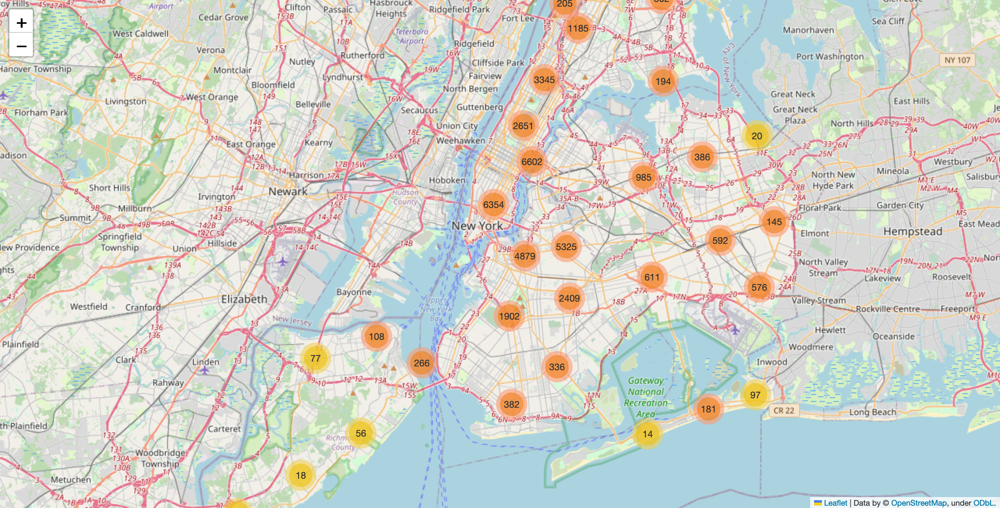

In [15]:
from folium.plugins import MarkerCluster, FastMarkerCluster #Using either is fine but I prefer FastMarkerCluster.

# Write your code below! Leave the instantiated variables: it is for your convenience.

df = pd.read_csv('/Users/jonathansuarez/Documents/GitHub/homework-2-aruvins/listings.csv')  # Read the Airbnb dataset

location_data = df.groupby(['latitude', 'longitude'])['price'].mean().reset_index() # Calculate the mean listing price per location

nyc_map = folium.Map(location=[40.693943, -73.985880], zoom_start=11) # Create a base map of New York City

marker_cluster = FastMarkerCluster(data=list(zip(location_data['latitude'], location_data['longitude'], location_data['price'])), name='Mean Listing Price') # Create a MarkerCluster for marker clustering

marker_cluster.add_to(nyc_map) # Add the marker cluster to the map

nyc_map.save('problem1a.html') # Save the map as a PNG file



convert_map_to_png(nyc_map, 'problem1a')

b) Plot a bar chart of the average price per neighbourhood group. Briefly comment on the relation between the price and neighbourhood group (use your map to analyze it). - (2.5 pts)

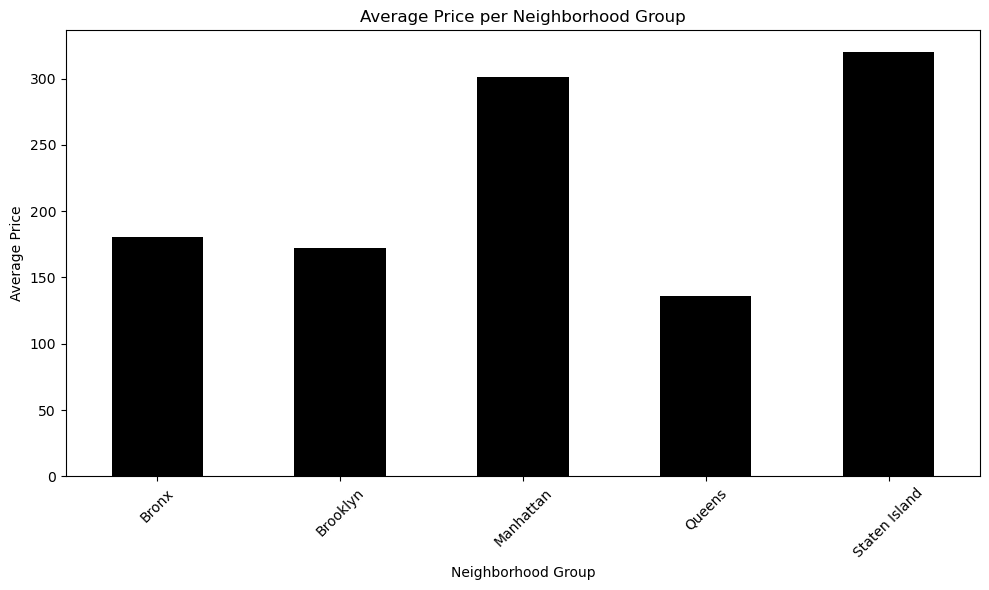

In [16]:
import matplotlib.pyplot as plt


avg_price_by_neighbourhood = df.groupby('neighbourhood_group')['price'].mean()

# Creating bar chart
plt.figure(figsize=(10, 6))
avg_price_by_neighbourhood.plot(kind='bar', color='black')
plt.title('Average Price per Neighborhood Group')
plt.xlabel('Neighborhood Group')
plt.ylabel('Average Price')
plt.xticks(rotation=45)  # Rotate x-axis labels for readability
plt.tight_layout()

# Show the bar chart
plt.show()

If we draw a straight line in the middle of the map, latitude ~40 N, every cluster that is closer to that latitude or in that latitude is more expensive, the farther it is the lower the price mean is. 

c) You're going to be living in New York City long term so you'd like to find places you can stay that are at minimum 300 days (inclusive). Plot a map that displays all the locations of these places. (Note: some could be in the same location) - (5 pts)


/var/folders/_5/c3bhqgf56mq78zc3l3f70j4w0000gn/T/ipykernel_3759/2073742675.py:2: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/Users/jonathansuarez/Documents/GitHub/homework-2-aruvins/listings.csv')  # Read the Airbnb dataset


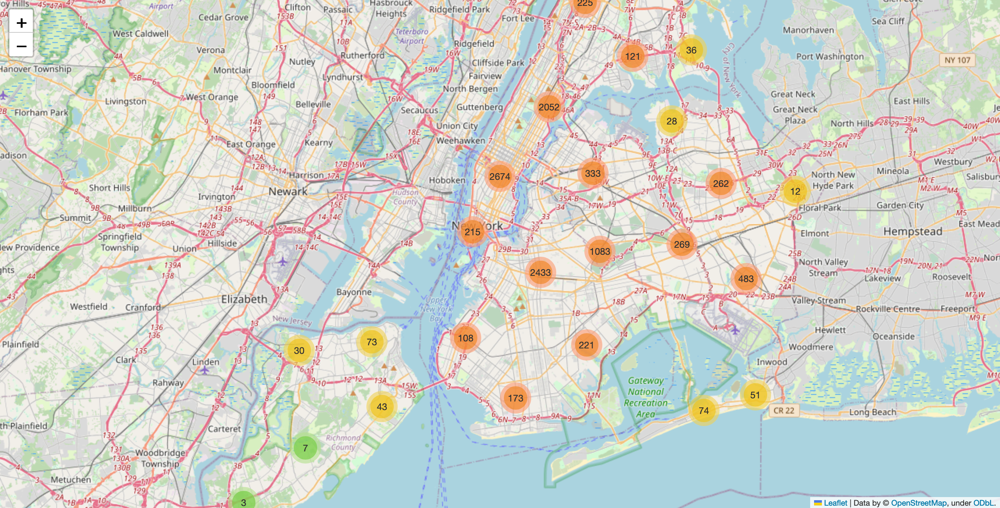

In [17]:
# Write your code below! Leave the instantiated variables: it is for your convenience.
df = pd.read_csv('/Users/jonathansuarez/Documents/GitHub/homework-2-aruvins/listings.csv')  # Read the Airbnb dataset

long_term_listings = df[df['availability_365'] >= 300]

nyc_map_2 = folium.Map(location=[40.693943, -73.985880], zoom_start=11)
marker_cluster = MarkerCluster().add_to(nyc_map_2)

for index, row in long_term_listings.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"Listing ID: {row['id']}\nAvailability: {row['availability_365']} days",
    ).add_to(marker_cluster)

# Save the map as an HTML file
nyc_map_2.save('long_term_listings_map_with_clusters.html')




convert_map_to_png(nyc_map_2, 'problem1c')

d) Using `longitude`, `latitude`, `price`, and `number_of_reviews`, use Density-based clustering to create clusters. Plot the points on the NYC map in a color corresponding to their cluster (color could be randomly assigned, but ensure each datapoint is colored to its associated cluster). 
For using `DBSCAN`, have the settings **`eps=0.3, min_samples=10`**. Use a `CircleMarker` with `radius=1`. Plot the clusters on the map and print the number of clusters made. - (15 pts)

/var/folders/_5/c3bhqgf56mq78zc3l3f70j4w0000gn/T/ipykernel_3759/3831052038.py:5: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/Users/jonathansuarez/Documents/GitHub/homework-2-aruvins/listings.csv')  # Read the Airbnb dataset
/var/folders/_5/c3bhqgf56mq78zc3l3f70j4w0000gn/T/ipykernel_3759/3831052038.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['cluster'] = dbscan.fit_predict(data)


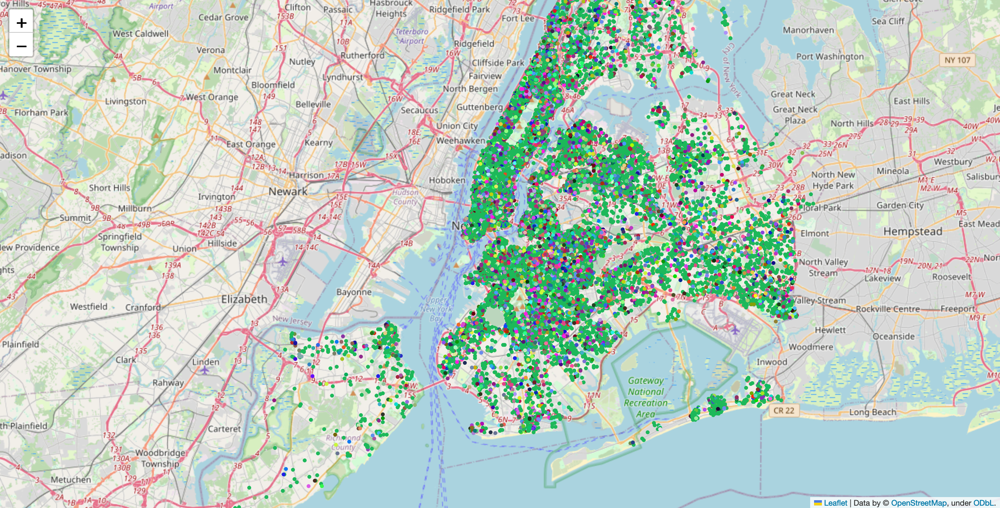

In [18]:
# Write your code below! Leave the instantiated variables: it is for your convenience.
from sklearn.cluster import DBSCAN
import random  # Import the random module

df = pd.read_csv('/Users/jonathansuarez/Documents/GitHub/homework-2-aruvins/listings.csv')  # Read the Airbnb dataset

data = df[['longitude', 'latitude', 'price', 'number_of_reviews']] #selecting features 


dbscan = DBSCAN(eps=0.3, min_samples=10)
data['cluster'] = dbscan.fit_predict(data)

nyc_map_3 = folium.Map(location=[40.693943, -73.985880], zoom_start=11)
marker_cluster = MarkerCluster().add_to(nyc_map_3) #cluster so its readable in map
# cluster_colors = [f'#{random.randint(0, 0xFFFFFF):06x}' for _ in range(len(data['cluster'].unique()))]

"""
for index, row in data.iterrows():
    cluster_idx = int(row['cluster'])  
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=1,
        color=cluster_colors[cluster_idx],
        fill=True,
        #fill_color=cluster_colors[cluster_idx],
        #fill_opacity=1
    ).add_to(marker_cluster)

# Print the number of clusters created
num_clusters = len(data['cluster'].unique())
print(num_clusters)

# Save the map as an HTML file
nyc_map_3.save('dbscan_clusters_map_with_clusters.html')

"""

cluster_colors = {}

for label in data['cluster']:
    if label not in cluster_colors:
        cluster_colors[label] = '#' + "%06x" % random.randint(0, 0xFFFFFF)
for index, row in df.iterrows():
    folium.CircleMarker([row['latitude'], row['longitude']], fill=True, color=cluster_colors[data['cluster'][index]], radius = 1).add_to(nyc_map_3)
    

convert_map_to_png(nyc_map_3, 'problem1d')

e) What would happen if you were to increase/decrease `eps`, and what would happen if you were to increase/decrease `min_samples`? Give some examples when running part d (you don't have to give the map image, just say something such as "When testing part d with ... ") - (5 points)

If you increase eps the minimum distance betweeen 2 points for them to be considered from the same cluster would increase, therefore the cluster size would increase. The same way, if we decrease eps, the cluster size would decrease. Moreover, if we decrease min_samples, less data points are necessary to have a centroid, so that could increase the number or cluster as cluster size would decrease. 

f) For part d, were the clusters seemed to be scattered or grouped together? Justify your answer. - (2.5 points)

looking at problem1d.png, they seem to be scattered, because we are not basing off of proximity, instead its based on price. 

g) For all listings of type `Shared room`, plot the dendrogram of the hierarchical clustering generated from `longitude`, `latitude`, and `price`. You can use any distance function. Describe your findings. - (10 points)

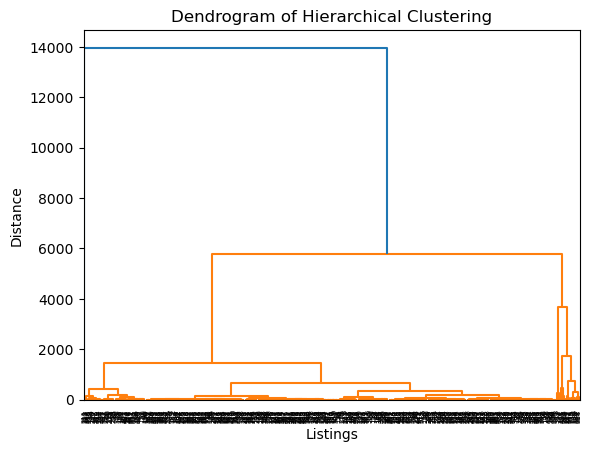

In [19]:
from scipy.cluster import hierarchy

shared_room_listings = df[df['room_type'] == 'Shared room']

attributes = shared_room_listings[['longitude', 'latitude', 'price']] #selecting features


linkage_matrix = hierarchy.linkage(attributes, method='ward')
dendrogram = hierarchy.dendrogram(linkage_matrix)


plt.title('Dendrogram of Hierarchical Clustering')
plt.xlabel('Listings')
plt.ylabel('Distance')


plt.show()

We can tell by this Dendrogram that the clusters are highly corellated, and it is not very easy to discover any relationships of this graph regarding longitude, latitude and price.

h) Normalize `longitude`, `latitude`, and `price` by subtracting by the mean (of the column) and dividing by the standard deviation (of the column). Repeat g) using the normalized data. Comment on what you observe. - (5 points)

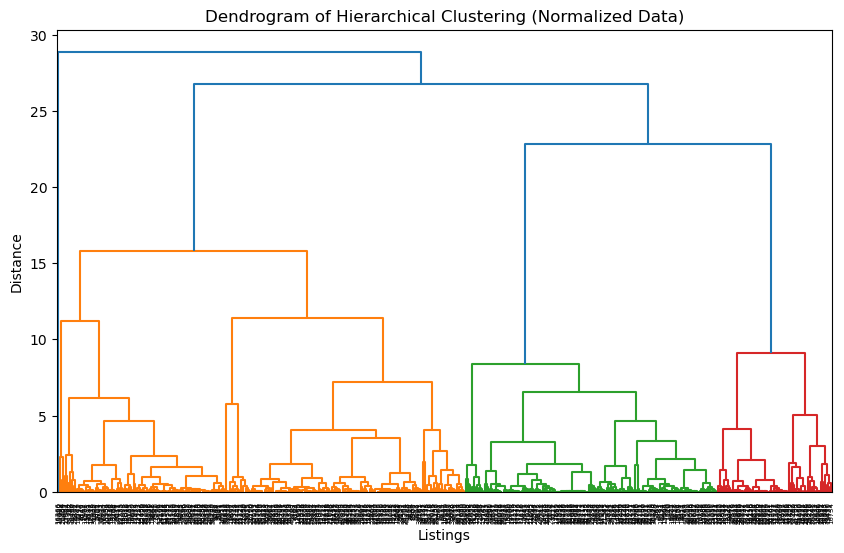

In [20]:
shared_room_listings = df[df['room_type'] == 'Shared room']

attributes = shared_room_listings[['longitude', 'latitude', 'price']]

means = attributes.mean(axis=0)
stds = attributes.std(axis=0)

normalized_attributes = (attributes - means) / stds

linkage_matrix = hierarchy.linkage(normalized_attributes, method='ward')
fig, ax = plt.subplots(figsize=(10, 6))
dendrogram = hierarchy.dendrogram(linkage_matrix, labels=shared_room_listings.index)

plt.title('Dendrogram of Hierarchical Clustering (Normalized Data)')
plt.xlabel('Listings')
plt.ylabel('Distance')
plt.show()

We can see that normalizing the attributes (longitude, latitude, and price) will give us more distinct clustering. We can see from the graph that there are 4 categories, which demonstrates better understanding for the attributes, and how they relate with each other.

## Exercise 2 (50 points)

a) Fetch the "mnist_784" data and store is as a `.csv` (that way you don't have to fetch it every time - which takes about 30s). (2.5 points)

In [21]:
import matplotlib.pyplot as plt

from sklearn.datasets import fetch_openml

X, y = fetch_openml(name="mnist_784", version=1, return_X_y=True, as_frame=False)

# your code here

# Save the NumPy array directly as a CSV file
np.savetxt('mnist_784.csv', X, delimiter=',')

/Users/jonathansuarez/anaconda3/lib/python3.11/site-packages/sklearn/datasets/_openml.py:1022: FutureWarning: The default value of `parser` will change from `'liac-arff'` to `'auto'` in 1.4. You can set `parser='auto'` to silence this warning. Therefore, an `ImportError` will be raised from 1.4 if the dataset is dense and pandas is not installed. Note that the pandas parser may return different data types. See the Notes Section in fetch_openml's API doc for details.
  warn(


b) Plot the singular value plot for a single example of the 9 digit (2.5 points)

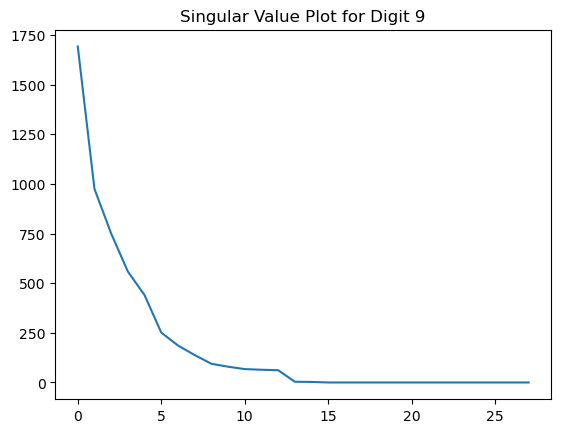

In [22]:
mnist_df = pd.read_csv('/Users/jonathansuarez/Documents/GitHub/homework-2-aruvins/mnist_784.csv')

nine_example = X[y == '9'][0]

u, s, vt = np.linalg.svd(nine_example.reshape(28, 28))


plt.plot(s)
plt.title("Singular Value Plot for Digit 9")
plt.show()

c) Just like we did in class with the image of the boat: By setting some singular values to 0, plot the approximation of an image of a 9 digit next to the original image. (5 points)

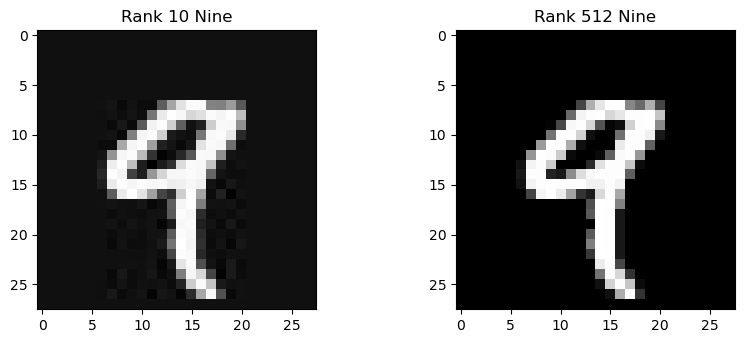

In [23]:
import matplotlib.cm as cm

scopy = s.copy()
scopy[10:] = 0.0

nine_app = u.dot(np.diag(scopy)).dot(vt)

#side by side representations 
plt.figure(figsize=(9, 6))
plt.subplot(1, 2, 1)
plt.imshow(nine_app, cmap=cm.Greys_r)
plt.title('Rank 10 Nine')

plt.subplot(1, 2, 2)
plt.imshow(nine_example.reshape(28, 28), cmap=cm.Greys_r)
plt.title('Rank 512 Nine')

_ = plt.subplots_adjust(wspace=0.5)
plt.show()


d) Consider the entire dataset as a matrix. Perform SVD and explain why / how you chose a particular rank. Note: you may not be able to run this on the entire dataset in a reasonable amount of time so you may take a small random sample for this and the following questions. (5 points)

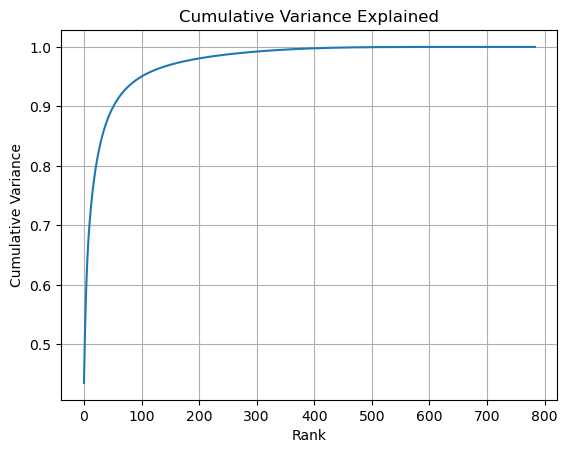

In [24]:
import numpy as np
from sklearn.datasets import fetch_openml

sample_size = 10000
random_indices = np.random.choice(len(X), sample_size, replace=False)
sampled_data = X[random_indices]


u, s, vt = np.linalg.svd(sampled_data, full_matrices=False)


cumulative_variance = np.cumsum(s**2) / np.sum(s**2)


import matplotlib.pyplot as plt
plt.plot(cumulative_variance)
plt.title("Cumulative Variance Explained")
plt.xlabel("Rank")
plt.ylabel("Cumulative Variance")
plt.grid()
plt.show()


Once I get to rank ~300, I get to a good balance between the reduction of parameters and accuracy.

e) Plot the first 10 singular vectors. Notice that each singular vector's length will be 784 so you can plot them as a 28x28 image. (5points)

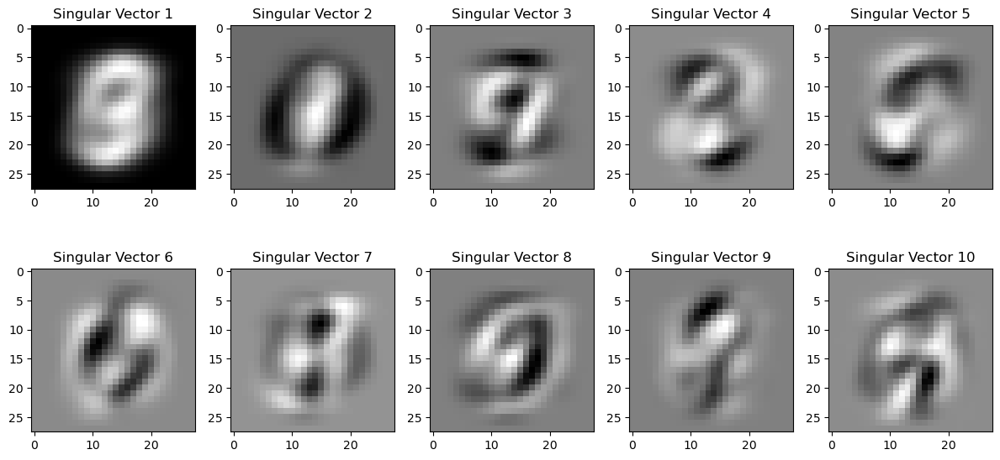

In [25]:
import matplotlib.pyplot as plt

first_10_singular_vectors_sampled = vt[:10, :] #selecting 10 first vectos 


plt.figure(figsize=(12, 6))
for i in range(10):
    plt.subplot(2, 5, i + 1)
    singular_vector = first_10_singular_vectors_sampled[i, :]
    singular_vector_image = singular_vector.reshape(28, 28)
    plt.imshow(singular_vector_image, cmap='gray')
    plt.title(f"Singular Vector {i + 1}")

plt.tight_layout()
plt.show()

f) Using Kmeans on this new dataset, cluster the images from d) using 10 clusters and plot the centroid of each cluster. Note: the centroids should be represented as images. (10 points)

/Users/jonathansuarez/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


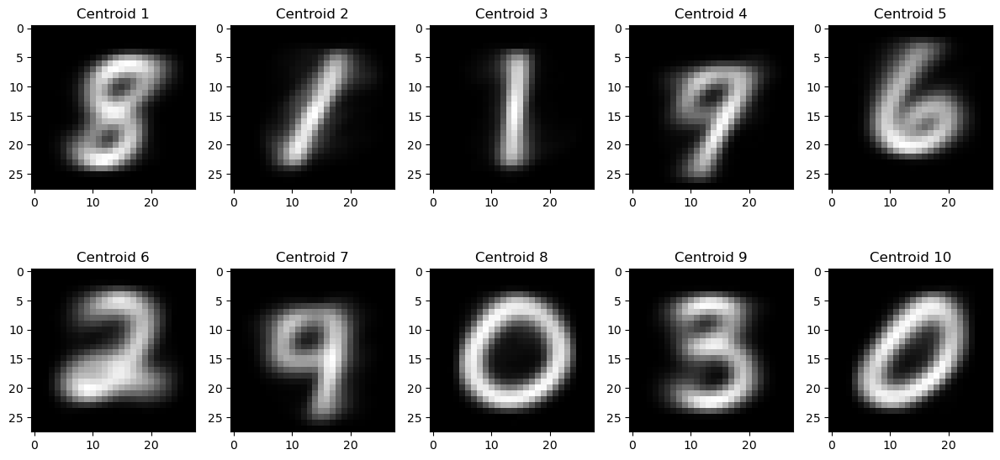

In [26]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

num_clusters = 10

kmeans = KMeans(n_clusters=num_clusters, random_state=0).fit(sampled_data)

centroids = kmeans.cluster_centers_

plt.figure(figsize=(12, 6))
for i in range(min(num_clusters, 10)):  # showing the 10 centroids
    plt.subplot(2, 5, i + 1)
    centroid_image = centroids[i].reshape(28, 28)
    plt.imshow(centroid_image, cmap='gray')
    plt.title(f'Centroid {i + 1}')

plt.tight_layout()
plt.show()


g) Repeat f) on the original dataset (if you used a subset of the dataset, keep using that same subset). Comment on any differences (or lack thereof) you observe between the centroids. (5 points)

/Users/jonathansuarez/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


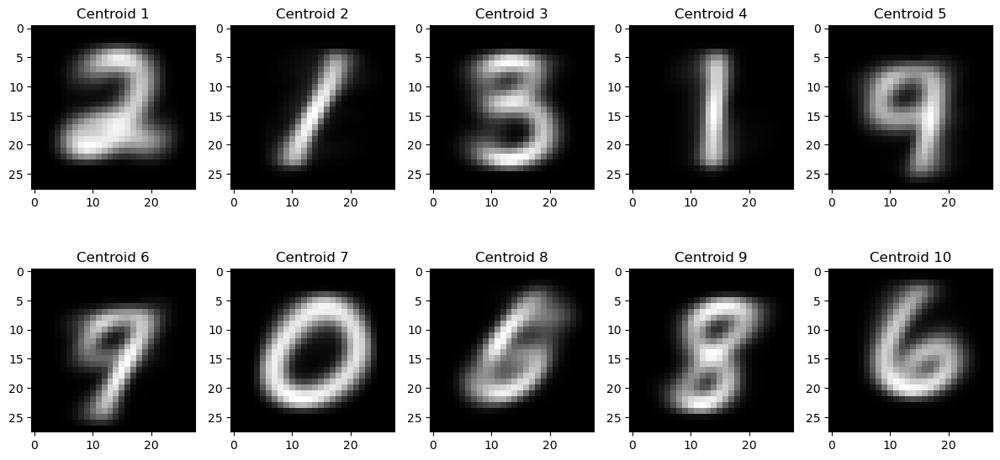

In [27]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt


num_clusters = 10

kmeans_full = KMeans(n_clusters=num_clusters, random_state=0).fit(mnist_df)

centroids = kmeans_full.cluster_centers_

plt.figure(figsize=(12, 6))
for i in range(min(num_clusters, 10)):  # showing the 10 centroids
    plt.subplot(2, 5, i + 1)
    centroid_image = centroids[i].reshape(28, 28)
    plt.imshow(centroid_image, cmap='gray')
    plt.title(f'Centroid {i + 1}')

plt.tight_layout()
plt.show()

The clusters between the sampled data (10000 images) are practically the same as the ones in the entire dataset which means the sample is a good representatio of the origial data set and the models are recognizing the same results.

h) Create a matrix (let's call it `O`) that is the difference between the original dataset and the rank-10 approximation of the dataset. (5 points)

In [28]:

sampled_df = pd.DataFrame(sampled_data)
mnist_df = pd.DataFrame(mnist_df)

# Calculate the difference matrix O
O = mnist_df - sampled_df

i) The largest (using euclidean distance from the origin) rows of the matrix `O` could be considered anomalous data points. Briefly explain why. Plot the 10 images responsible for the 10 largest rows of that matrix `O`. (10 points)

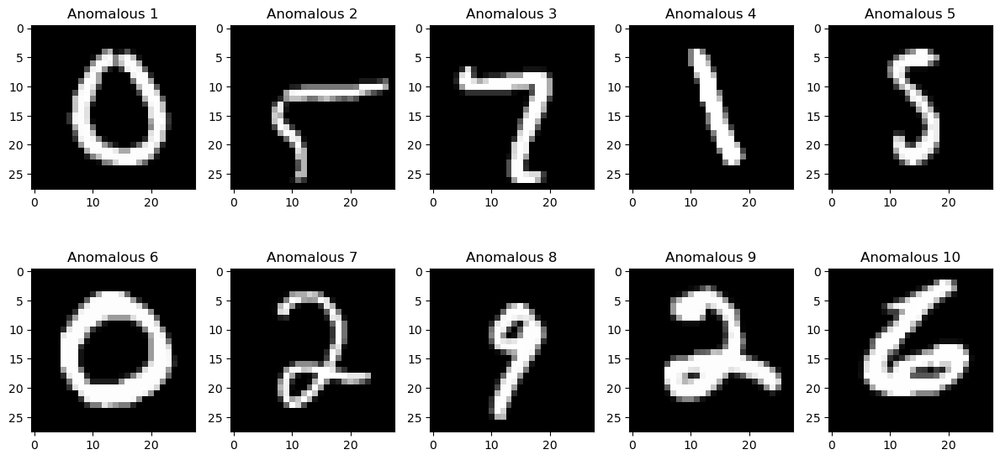

In [29]:
import numpy as np
import matplotlib.pyplot as plt

# Calculate the Euclidean distances for each row in matrix O
distances = np.linalg.norm(O, axis=1)

# Find the indices of the 10 largest distances
largest_indices = np.argsort(distances)[-10:]

# Retrieve and plot the 10 images responsible for the largest rows of O
plt.figure(figsize=(12, 6))
for i, index in enumerate(largest_indices):
    plt.subplot(2, 5, i + 1)
    image = mnist_df.iloc[index].values.reshape(28, 28)
    plt.imshow(image, cmap='gray')
    plt.title(f'Anomalous {i + 1}')

plt.tight_layout()
plt.show()

Because if the data point from the original set and the rank10 set is equal or very similar this means the difference will be close to 0. On the contrary, if the data point is very different the difference will be very big, which shows the point the points that deviate the most from the original set, which does not work well for generalization (could generate errors). 

## Bonus (20pts)

Re-using the dbscan code written in class, reproduce the following animation of the dbscan algorithm

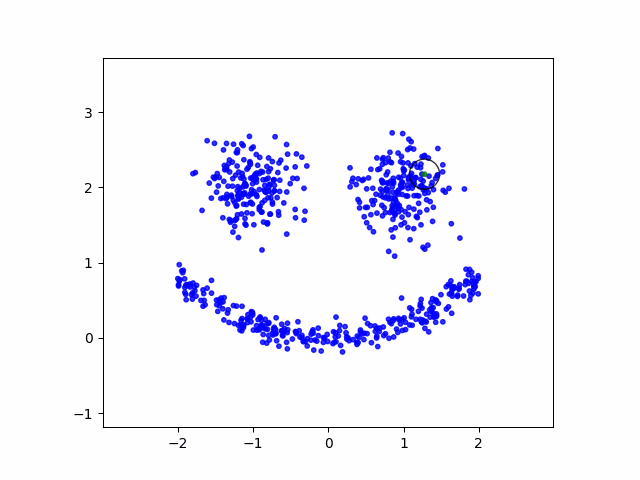

In [30]:
from IPython.display import Image
Image(filename="dbscan.gif", width=500, height=500)

Hints:

- First animate the dbscan algorithm for the dataset used in class (before trying to create the above dataset)
- Take a snapshot of the assignments when the point gets assigned to a cluster
- Confirm that the snapshot works by saving it to a file
- Don't forget to close the matplotlib plot after saving the figure
- Gather the snapshots in a list of images that you can then save as a gif using the code below
- Use `ax.set_aspect('equal')` so that the circles don't appear to be oval shaped
- To create the above dataset you need two blobs for the eyes. For the mouth you can use the following process to generate (x, y) pairs:
  - Pick an x at random in an interval that makes sense given where the eyes are positioned
  - For that x generate y that is 0.2 * x^2 plus a small amount of randomness
  - `zip` the x's and y's together and append them to the dataset containing the blobs



In [31]:
import numpy as np
from PIL import Image as im
import matplotlib.pyplot as plt
import sklearn.datasets as datasets

TEMPFILE = 'temp.png'

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts 
        self.epsilon = epsilon
        self.snaps = []


    def snapshot(self):
        fig, ax = plt.subplots()
        colors = ...

        ax.scatter(...)
        cir = plt.Circle(...) # create circle around the point assigned
        ax.add_patch(cir)
        ax.set_xlim(...)
        ax.set_ylim(...)
        ax.set_aspect('equal') # necessary or else the circles appear to be oval shaped

        fig.savefig(TEMPFILE)
        plt.close()

        return im.fromarray(np.asarray(im.open(TEMPFILE)))


    def dbscan(self):
        ...
        return


centers = [...]
eyes, _ = datasets.make_blobs(...)

mouth_x = ... * np.random.random(...)
mouth_y = ... + .1 * np.random.randn(...)

face = np.append(eyes, ..., axis=0)

dbc = DBC(face, ..., ...)
clustering = dbc.dbscan()

dbc.snaps[0].save(
    'dbscan.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)

InvalidParameterError: The 'n_samples' parameter of make_blobs must be an int in the range [1, inf) or an array-like. Got Ellipsis instead.